<a href="https://colab.research.google.com/github/sahroush/AI-Spring2024/blob/main/Projects/1/Project_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Task 1**

## **A: Classification using VGG16 and ResNet50**

### **Part 1: VGG Without Data Augmentation**

Since our dataset is small, it really isn't possible to train a model without overfitting (given the complex architecture of VGG16).\
We'll be using **transfer learning** and make use of the pretrained VGG model.

Let us start by reading the dataset.

In [ ]:
from google.colab import drive

drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
import os

os.chdir("drive")
os.chdir("MyDrive")
os.chdir("Data-Dermoscopic _Images")

# Get the current working directory
current_directory = os.getcwd()

# List all files and directories in the current working directory
files_in_directory = os.listdir(current_directory)

# Print the list of files
print("Files in the current working directory:")
for file in files_in_directory:
    print(file)

Files in the current working directory:
Nevus
Melanoma
Carcinoma


In [ ]:
import cv2
import numpy as np

label_names = ["Nevus", "Melanoma", "Carcinoma"]

images = []
labels = []

for label, subfolder in enumerate(label_names):
    subfolder_path = subfolder
    for image_file in os.listdir(subfolder_path):
        image_path = os.path.join(subfolder_path, image_file)
        # Read the image
        image = cv2.imread(image_path)
        image = cv2.resize(image, (224, 224))
        images.append(image)
        labels.append(label)

# Convert lists to numpy arrays
images = np.array(images)
labels = np.array(labels)

Let us split them into train and test sets.

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

shuffled_images, shuffled_labels = shuffle(images, labels)

train_images, test_images, train_labels, test_labels = train_test_split(shuffled_images, shuffled_labels, test_size=0.2, stratify=shuffled_labels)

In [ ]:
print(f"Train dataset size: {len(train_images)}")
print(f"Test dataset size: {len(test_images)}")

Train dataset size: 138
Test dataset size: 35


Let's see some of the images

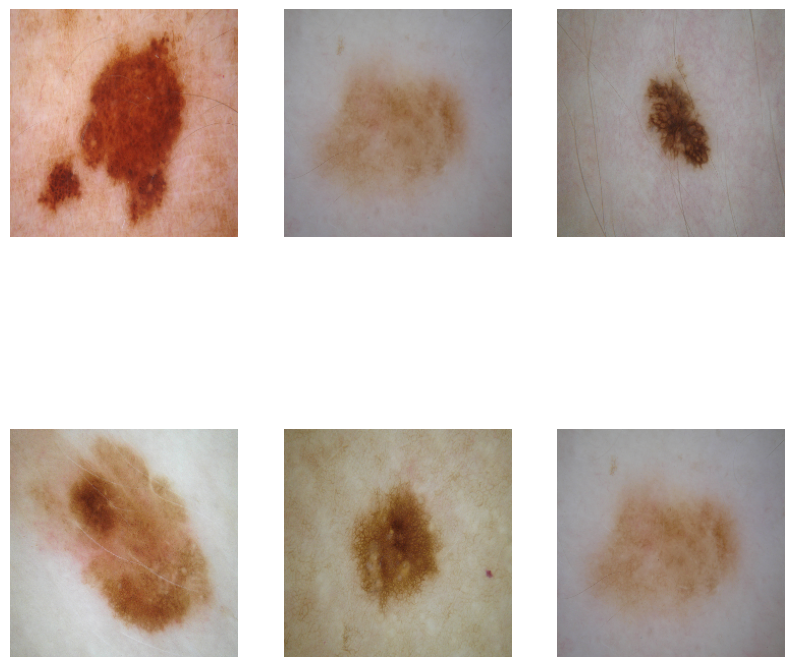

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
for i in range(6):
    plt.subplot(2, 3, i + 1)
    plt.imshow(cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for display
    plt.axis('off')

plt.show()

Now let us use this small dataset to train VGG16 while employing transfer leaerning.

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential

Let us convert the categories into one-hot encoded vectors.

In [ ]:
from tensorflow.keras.utils import to_categorical

train_labels = to_categorical(train_labels)
test_labels = to_categorical(test_labels)

Now let us use the initial layers of VGG16 and freeze them for transfer learning.

In [ ]:
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input

base_model = VGG16(weights="imagenet", include_top=False, input_shape=images[0].shape)

num_layers_to_freeze = 17

for layer in base_model.layers[:num_layers_to_freeze]:
    layer.trainable = False

base_model.summary()

58889256/58889256 [==============================] - 2s 0us/step
Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                              

We should preproccess the images to make sure that they meet VGG requirements.

In [ ]:
train_images = preprocess_input(train_images)
test_images = preprocess_input(test_images)

Now we can build our model.

In [ ]:
from tensorflow.keras.layers import Dense, Dropout, Flatten, GlobalAveragePooling2D

model = Sequential([
    base_model,
    Flatten(),
    Dropout(0.9),
    Dense(3, activation='softmax'),
])

model.build([None, 224, 224, 3]) #input shape

model.summary()

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 flatten_3 (Flatten)         (None, 25088)             0         
                                                                 
 dropout_3 (Dropout)         (None, 25088)             0         
                                                                 
 dense_6 (Dense)             (None, 3)                 75267     
                                                                 
Total params: 14789955 (56.42 MB)
Trainable params: 2435075 (9.29 MB)
Non-trainable params: 12354880 (47.13 MB)
_________________________________________________________________


We now can train our model.

In [ ]:
model.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy'],
)


# Train the model
history = model.fit(
    train_images,
    train_labels,
    batch_size=32,
    epochs=10,
    validation_split=0.2,
)

loss, accuracy = model.evaluate(test_images, test_labels)

print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
4/4 [==============================] - 4s 256ms/step - loss: 10.8755 - accuracy: 0.7818 - val_loss: 6.2787 - val_accuracy: 0.7857
Epoch 2/10
4/4 [==============================] - 1s 156ms/step - loss: 15.7586 - accuracy: 0.6545 - val_loss: 5.8738 - val_accuracy: 0.7500
Epoch 3/10
4/4 [==============================] - 1s 169ms/step - loss: 6.9782 - accuracy: 0.8273 - val_loss: 6.0334 - val_accuracy: 0.7500
Epoch 4/10
4/4 [==============================] - 1s 160ms/step - loss: 5.3612 - accuracy: 0.8364 - val_loss: 7.1094 - val_accuracy: 0.8571
Epoch 5/10
4/4 [==============================] - 1s 166ms/step - loss: 5.7451 - accuracy: 0.8818 - val_loss: 6.8343 - val_accuracy: 0.8929
Epoch 6/10
4/4 [==============================] - 1s 167ms/step - loss: 7.8230 - accuracy: 0.8364 - val_loss: 4.6642 - val_accuracy: 0.8929
Epoch 7/10
4/4 [==============================] - 1s 166ms/step - loss: 6.2439 - accuracy: 0.8364 - val_loss: 8.3712 - val_accuracy: 0.7500
Epoch 8/10
4/4 [==

This is fairly fine given the complexity of VGG and the lack of data. Overfitting was to be expected.

Let us generate the classification report.

In [ ]:
from sklearn.metrics import classification_report

predictions = model.predict(test_images)

# Convert one-hot encoded predictions to class labels
predicted_classes = np.argmax(predictions, axis=1)

# Convert one-hot encoded true labels to class labels
true_labels = np.argmax(test_labels, axis=1)

vgg_no_aug_report = classification_report(true_labels, predicted_classes)

print(vgg_no_aug_report)

2/2 [==============================] - 0s 158ms/step
              precision    recall  f1-score   support

           0       1.00      0.83      0.91        12
           1       0.91      0.77      0.83        13
           2       0.71      1.00      0.83        10

    accuracy                           0.86        35
   macro avg       0.87      0.87      0.86        35
weighted avg       0.88      0.86      0.86        35



### **Part 2: ResNet without data augmentation**

We'll be doing the exact same thing as part 1 but we'll be using ResNet instead of VGG.

In [ ]:
from tensorflow.keras.applications import ResNet50

base_model = ResNet50(weights='imagenet', include_top=False, input_shape=images[0].shape)

num_layers_to_freeze = len(base_model.layers) - 3

for layer in base_model.layers[:num_layers_to_freeze]:
    layer.trainable = False

94765736/94765736 [==============================] - 3s 0us/step


We can now build our model.

In [ ]:
from tensorflow.keras.layers import Dense, Dropout, Flatten, GlobalAveragePooling2D

model = Sequential([
    base_model,
    Flatten(),
    Dropout(0.9),
    Dense(3, activation='softmax'),
])

model.build([None, 224, 224, 3]) #input shape

model.summary()

Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 7, 7, 2048)        23587712  
                                                                 
 flatten_5 (Flatten)         (None, 100352)            0         
                                                                 
 dropout_5 (Dropout)         (None, 100352)            0         
                                                                 
 dense_8 (Dense)             (None, 3)                 301059    
                                                                 
Total params: 23888771 (91.13 MB)
Trainable params: 305155 (1.16 MB)
Non-trainable params: 23583616 (89.96 MB)
_________________________________________________________________


Now that the model is ready, we can train it.

In [ ]:
model.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy'],
)


# Train the model
history = model.fit(
    train_images,
    train_labels,
    batch_size=32,
    epochs=10,
    validation_split=0.2,
)

loss, accuracy = model.evaluate(test_images, test_labels)

print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
4/4 [==============================] - 7s 479ms/step - loss: 5.2622 - accuracy: 0.3182 - val_loss: 0.3786 - val_accuracy: 0.8214
Epoch 2/10
4/4 [==============================] - 0s 122ms/step - loss: 1.2330 - accuracy: 0.8455 - val_loss: 0.6301 - val_accuracy: 0.9286
Epoch 3/10
4/4 [==============================] - 0s 122ms/step - loss: 1.2333 - accuracy: 0.8455 - val_loss: 0.7437 - val_accuracy: 0.8571
Epoch 4/10
4/4 [==============================] - 0s 122ms/step - loss: 0.5663 - accuracy: 0.9364 - val_loss: 0.4789 - val_accuracy: 0.8571
Epoch 5/10
4/4 [==============================] - 0s 125ms/step - loss: 0.6882 - accuracy: 0.8909 - val_loss: 0.9499 - val_accuracy: 0.8929
Epoch 6/10
4/4 [==============================] - 0s 126ms/step - loss: 0.4957 - accuracy: 0.9000 - val_loss: 0.7621 - val_accuracy: 0.9286
Epoch 7/10
4/4 [==============================] - 0s 123ms/step - loss: 0.4730 - accuracy: 0.9364 - val_loss: 0.4131 - val_accuracy: 0.8929
Epoch 8/10
4/4 [====

Finally we can generate the Classification report.

In [ ]:
from sklearn.metrics import classification_report

predictions = model.predict(test_images)

# Convert one-hot encoded predictions to class labels
predicted_classes = np.argmax(predictions, axis=1)

# Convert one-hot encoded true labels to class labels
true_labels = np.argmax(test_labels, axis=1)

resnet_no_aug_report = classification_report(true_labels, predicted_classes)

print(resnet_no_aug_report)

2/2 [==============================] - 3s 124ms/step
              precision    recall  f1-score   support

           0       0.91      0.83      0.87        12
           1       0.92      0.85      0.88        13
           2       0.83      1.00      0.91        10

    accuracy                           0.89        35
   macro avg       0.89      0.89      0.89        35
weighted avg       0.89      0.89      0.88        35



### **Part 3: VGG with data augmentation**

Let us employ data augmentation to get a bigger dataset (I'll discuss the advantages and disadvantages of this method in part B).

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.1,
    height_shift_range=0.1,
    zoom_range=0.1,
    fill_mode='nearest'     # Fill mode for points outside the input boundaries
)

train_generator = train_datagen.flow(train_images, train_labels, batch_size=32)

Now that we have a data generator, we can build our model.

In [ ]:
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input

base_model = VGG16(weights="imagenet", include_top=False, input_shape=images[0].shape)

num_layers_to_freeze = 17

for layer in base_model.layers[:num_layers_to_freeze]:
    layer.trainable = False

from tensorflow.keras.layers import Dense, Dropout, Flatten, GlobalAveragePooling2D

model = Sequential([
    base_model,
    Flatten(),
    Dropout(0.5),
    Dense(50, activation='relu'),
    Dropout(0.1),
    Dense(20, activation='relu'),
    Dense(3, activation='softmax'),
])

model.build([None, 224, 224, 3]) #input shape

model.summary()

Model: "sequential_23"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 flatten_17 (Flatten)        (None, 25088)             0         
                                                                 
 dropout_21 (Dropout)        (None, 25088)             0         
                                                                 
 dense_30 (Dense)            (None, 50)                1254450   
                                                                 
 dropout_22 (Dropout)        (None, 50)                0         
                                                                 
 dense_31 (Dense)            (None, 20)                1020      
                                                                 
 dense_32 (Dense)            (None, 3)               

And we can train it.

In [ ]:
model.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy'],
)


# Train the model
history = model.fit(
    train_generator,
    steps_per_epoch=train_images.shape[0] // 32,
    batch_size=32,
    epochs=10
)

loss, accuracy = model.evaluate(test_images, test_labels)

print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
4/4 [==============================] - 5s 292ms/step - loss: 1.0800 - accuracy: 0.8113
Epoch 2/10
4/4 [==============================] - 2s 371ms/step - loss: 0.7780 - accuracy: 0.7891
Epoch 3/10
4/4 [==============================] - 1s 307ms/step - loss: 1.0827 - accuracy: 0.7736
Epoch 4/10
4/4 [==============================] - 1s 372ms/step - loss: 0.5848 - accuracy: 0.8396
Epoch 5/10
4/4 [==============================] - 1s 285ms/step - loss: 0.6842 - accuracy: 0.7925
Epoch 6/10
4/4 [==============================] - 2s 429ms/step - loss: 0.6663 - accuracy: 0.8019
Epoch 7/10
4/4 [==============================] - 2s 463ms/step - loss: 0.6547 - accuracy: 0.8208
Epoch 8/10
4/4 [==============================] - 2s 360ms/step - loss: 0.5811 - accuracy: 0.8281
Epoch 9/10
4/4 [==============================] - 1s 281ms/step - loss: 0.7361 - accuracy: 0.8491
Epoch 10/10
2/2 [==============================] - 0s 31ms/step - loss: 1.7865 - accuracy: 0.8857
Test Loss: 1.7864856

We now can view our classification report.

In [ ]:
from sklearn.metrics import classification_report

predictions = model.predict(test_images)

# Convert one-hot encoded predictions to class labels
predicted_classes = np.argmax(predictions, axis=1)

# Convert one-hot encoded true labels to class labels
true_labels = np.argmax(test_labels, axis=1)

vgg_aug_report = classification_report(true_labels, predicted_classes)

print(vgg_aug_report)

2/2 [==============================] - 0s 158ms/step
              precision    recall  f1-score   support

           0       0.90      0.75      0.82        12
           1       0.86      0.92      0.89        13
           2       0.91      1.00      0.95        10

    accuracy                           0.89        35
   macro avg       0.89      0.89      0.89        35
weighted avg       0.89      0.89      0.88        35



### **Part 4: ResNet with augmentation**

In [ ]:
from tensorflow.keras.applications import ResNet50

base_model = ResNet50(weights='imagenet', include_top=False, input_shape=images[0].shape)

num_layers_to_freeze = len(base_model.layers)

for layer in base_model.layers[:num_layers_to_freeze]:
    layer.trainable = False

model = Sequential([
    base_model,
    Flatten(),
    Dropout(0.5),
    Dense(3, activation='softmax'),
])

model.build([None, 224, 224, 3]) #input shape

model.summary()

Model: "sequential_28"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 7, 7, 2048)        23587712  
                                                                 
 flatten_22 (Flatten)        (None, 100352)            0         
                                                                 
 dropout_30 (Dropout)        (None, 100352)            0         
                                                                 
 dense_43 (Dense)            (None, 3)                 301059    
                                                                 
Total params: 23888771 (91.13 MB)
Trainable params: 301059 (1.15 MB)
Non-trainable params: 23587712 (89.98 MB)
_________________________________________________________________


In [ ]:
model.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy'],
)


# Train the model
history = model.fit(
    train_generator,
    steps_per_epoch=train_images.shape[0] // 32,
    batch_size=32,
    epochs=10,
)

loss, accuracy = model.evaluate(test_images, test_labels)

print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
4/4 [==============================] - 6s 426ms/step - loss: 5.4918 - accuracy: 0.3962
Epoch 2/10
4/4 [==============================] - 1s 264ms/step - loss: 5.4042 - accuracy: 0.5566
Epoch 3/10
4/4 [==============================] - 1s 275ms/step - loss: 6.4421 - accuracy: 0.6509
Epoch 4/10
4/4 [==============================] - 1s 358ms/step - loss: 3.1996 - accuracy: 0.7891
Epoch 5/10
4/4 [==============================] - 1s 270ms/step - loss: 2.6585 - accuracy: 0.8491
Epoch 6/10
4/4 [==============================] - 2s 373ms/step - loss: 1.4449 - accuracy: 0.8585
Epoch 7/10
4/4 [==============================] - 2s 629ms/step - loss: 0.4862 - accuracy: 0.9245
Epoch 8/10
4/4 [==============================] - 1s 269ms/step - loss: 0.5812 - accuracy: 0.9151
Epoch 9/10
4/4 [==============================] - 1s 358ms/step - loss: 0.6900 - accuracy: 0.9062
Epoch 10/10
2/2 [==============================] - 1s 32ms/step - loss: 3.5606 - accuracy: 0.8571
Test Loss: 3.5605664

In [ ]:
from sklearn.metrics import classification_report

predictions = model.predict(test_images)

# Convert one-hot encoded predictions to class labels
predicted_classes = np.argmax(predictions, axis=1)

# Convert one-hot encoded true labels to class labels
true_labels = np.argmax(test_labels, axis=1)

resnet_aug_report = classification_report(true_labels, predicted_classes)

print(resnet_aug_report)

2/2 [==============================] - 1s 119ms/step
              precision    recall  f1-score   support

           0       0.91      0.83      0.87        12
           1       0.91      0.77      0.83        13
           2       0.77      1.00      0.87        10

    accuracy                           0.86        35
   macro avg       0.86      0.87      0.86        35
weighted avg       0.87      0.86      0.86        35



In [ ]:
print("### VGG (No Augmentation)")
print(vgg_no_aug_report)
print("### ResNet (No Augmentation)")
print(resnet_no_aug_report)
print("### VGG (With Augmentation)")
print(vgg_aug_report)
print("### ResNet (With Augmentation)")
print(resnet_aug_report)

### VGG (No Augmentation)
              precision    recall  f1-score   support

           0       1.00      0.83      0.91        12
           1       0.91      0.77      0.83        13
           2       0.71      1.00      0.83        10

    accuracy                           0.86        35
   macro avg       0.87      0.87      0.86        35
weighted avg       0.88      0.86      0.86        35

### ResNet (No Augmentation)
              precision    recall  f1-score   support

           0       0.91      0.83      0.87        12
           1       0.92      0.85      0.88        13
           2       0.83      1.00      0.91        10

    accuracy                           0.89        35
   macro avg       0.89      0.89      0.89        35
weighted avg       0.89      0.89      0.88        35

### VGG (With Augmentation)
              precision    recall  f1-score   support

           0       0.90      0.75      0.82        12
           1       0.86      0.92      0.89   

## **B: The Architecture of VGG16 and Resnet50**



### **VGG16**

![vgg16](https://www.researchgate.net/profile/Timea-Bezdan/publication/333242381/figure/fig2/AS:760979981860866@1558443174380/VGGNet-architecture-19.ppm)\
*Source: [researchgate](https://www.researchgate.net/profile/Timea-Bezdan/publication/333242381/figure/fig2/AS:760979981860866@1558443174380/VGGNet-architecture-19.ppm)*

![layers](https://miro.medium.com/v2/resize:fit:4800/format:webp/0*6VP81rFoLWp10FcG)\
*Source: [medium](https://medium.com/@mygreatlearning/everything-you-need-to-know-about-vgg16-7315defb5918)*

In VGG16 there are thirteen convolutional layers, five Max Pooling layers, and three Dense layers which sum up to 21 layers but it has only sixteen weight layers i.e., learnable parameters layer.

- **Input:** VGG16 receives a $224 \times 224$ image input.
- **Convolutional layers:** Instead of having a large number of hyper-parameters VGG focuses on having convolution layers of $3 \times 3$, filter with stride 1 and always used the same padding and maxpool layer of 2x2 filter of stride 2.
- **Pooling layers:** A pooling layer follows several convolutional layers—this helps reduce the dimensionality and the number of parameters of the feature maps created by each convolution step. Pooling is crucial given the rapid growth of the number of available filters from 64 to 128, 256, and eventually 512 in the final layers.

- **Dense layers:** Three Fully-Connected (FC) layers follow a stack of convolutional layers: the first two have 4096 neurons each, the third performs 1000-way classification and thus contains 1000 neurons (one for each class) (Thus final layer is the soft-max layer).

### **ResNet**

![Skip connections](https://github.com/sahroush/Personal-stuff/blob/wtf/res.png?raw=true)

ResNet is fairly deep and we know that training deep models comes with a handful of problems. The key to being able to train such a deep network is to use **skip connections**.

What are **skip connections**? The signal feeding into a layer is also added to the output of a layer located a bit higher up the stack.
The network will be making a target function $h(x)$, by usig a skip connection and adding $x$ to the output of the network, the network will be forced to model $f(x) = h(x) - x$.

How does this help? Regular NNs have weights close to zero at initialization. So the value of $f(x)$ would be close to zero. This means that it initially models the identity function $I(x)=x$. If the target function is fairly close to the identity function, this will speed up training.

![Block](https://github.com/sahroush/Personal-stuff/blob/wtf/block.png?raw=true)

By adding many skip connections, the network can start making progress even if several layers have not started learning yet. Thus we view the residual network as a stack of `residual units` (RUs), where each residual unit is a small neural network with a skip connection.

![ResNet](https://github.com/sahroush/Personal-stuff/blob/wtf/arch.png?raw=true)

It starts with convolutional layers to extract the basic features, and in between is just a very deep stack of simple residual units. Each residual unit is composed of two convolutional layers (and no pooling layer!), with Batch Normalization (BN) and ReLU activation, using $3 \times 3$ kernels and preserving spatial dimensions (stride 1, `"same"` padding). The final layers are the fully connected layers, the fully connected layers map the learned features to the final output classes.




## **C: Explanation of the codes for VGG16 and ResNet50 with Data Augmentation**

Refer to parts 3 and 4 of section A.

## **D: The Advantages and Disadvantages of Data Augmentation**

![Augmentation](https://miro.medium.com/v2/resize:fit:720/format:webp/1*KL_HqR2bU9yvMLce9ilPxg.png)\
*Source: [Medium](https://medium.com/analytics-vidhya/data-augmentation-is-it-really-necessary-b3cb12ab3c3f)*

**Advantages**:
- **Improved Generalization**: Since the model is exposed to a variety of samples, it learns to generalize better.
- **Reduced Data Dependency**: Data augmentation techniques increase the effectiveness of smaller datasets, vastly reducing the dependency on large datasets in training environments.
- **Improved data privacy**: Augmentation techniques can be used on the existing data to create synthetic data. This augmented data retains the input data's statistical properties and weights while protecting and limiting access to the original.
-**Resistance to invarients**: For example, if the task is image classification, augmentations like rotation and flipping can help the model recognize objects regardless of their orientation or position in the image.

**Disadvantages**:
- **Risk of overfitting to the augmented data**: If the augmentation strategy is too aggressive or specific, the model might become biased towards the augmented data.
-  **Loss of Data Quality**: For example, excessive rotation or cropping may distort important features in the images, making them less suitable for training.
- **Increased computational cost**: It can lead to longer training times and higher resource requirements.

# **Task 2**

## **A: Creating a Deep Convolutional GAN for the CIFAR-10 dataset**

We start by loading the dataset.

In [ ]:
from tensorflow.keras.datasets import cifar10

(train_images, _), (_, _) = cifar10.load_data()

170498071/170498071 [==============================] - 3s 0us/step


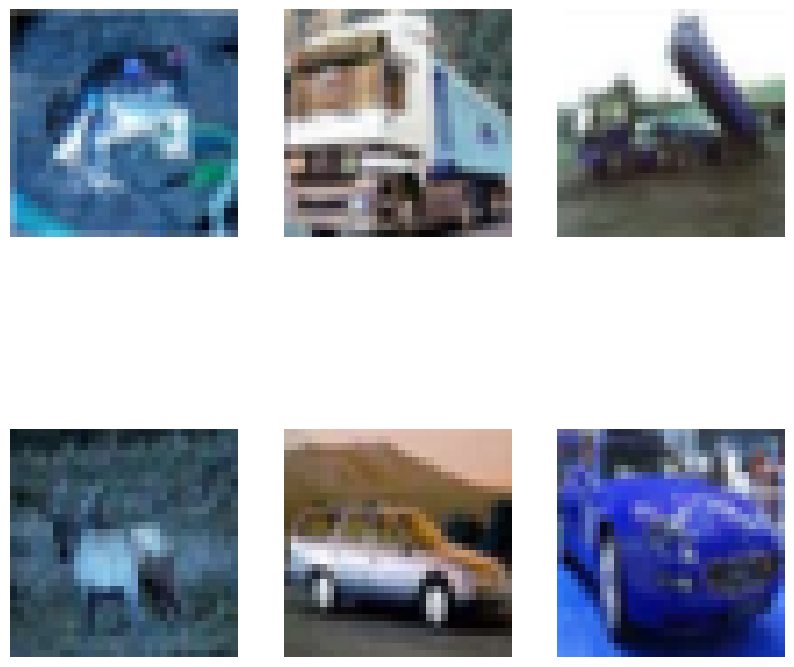

In [ ]:
import matplotlib.pyplot as plt
import cv2

plt.figure(figsize=(10, 10))
for i in range(6):
    plt.subplot(2, 3, i + 1)
    plt.imshow(cv2.cvtColor(train_images[i], cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for display
    plt.axis('off')

plt.show()

We should also normilize our images.

In [ ]:
train_images = (train_images - 127.5) / 127.5  # Normalize images to [-1, 1]

Next, we make our generator model.

The model will be given a vector of 100 noise inputs.
I'll be trying to create 64 8*8 feature maps.

In [ ]:
from keras.layers import Dense, Reshape, LeakyReLU, Conv2D, UpSampling2D
from keras.models import Sequential

codings_size = 100
generator = Sequential([
    #Creating the feature maps
    Dense(8 * 8 * 64, input_shape=[codings_size]),
    LeakyReLU(alpha=0.2),
    Reshape((8, 8, 64)),
    #Upsampling the images to 16*16
    UpSampling2D(),
    Conv2D(128, (3, 3), activation='relu', padding='same'),
    #Upsampling the images to 32*32
    UpSampling2D(),
    Conv2D(128, (3, 3), activation='relu', padding='same'),
    #Output layer
    Conv2D(3, (3, 3), activation='tanh', padding='same')
])

generator.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 4096)              413696    
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 4096)              0         
                                                                 
 reshape (Reshape)           (None, 8, 8, 64)          0         
                                                                 
 up_sampling2d (UpSampling2  (None, 16, 16, 64)        0         
 D)                                                              
                                                                 
 conv2d (Conv2D)             (None, 16, 16, 128)       73856     
                                                                 
 up_sampling2d_1 (UpSamplin  (None, 32, 32, 128)       0         
 g2D)                                                   

Then we'll make our discriminator.

In [ ]:
from keras.layers import Flatten, Dropout

discriminator = Sequential([
    #input
    Conv2D(64, (3,3), padding='same', input_shape=(32, 32, 3)),
    LeakyReLU(alpha=0.2),
    #downsample
    Conv2D(128, (3,3), strides=(2,2), padding='same'),
    LeakyReLU(alpha=0.2),
    #downsample
    Conv2D(128, (3,3), strides=(2,2), padding='same'),
    LeakyReLU(alpha=0.2),
    #downsample
    Conv2D(256, (3,3), strides=(2,2), padding='same'),
    LeakyReLU(alpha=0.2),
    #classification
    Flatten(),
    Dropout(0.5),
    Dense(1, activation='sigmoid')
])

discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 32, 32, 64)        1792      
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 32, 32, 64)        0         
                                                                 
 conv2d_4 (Conv2D)           (None, 16, 16, 128)       73856     
                                                                 
 leaky_re_lu_2 (LeakyReLU)   (None, 16, 16, 128)       0         
                                                                 
 conv2d_5 (Conv2D)           (None, 8, 8, 128)         147584    
                                                                 
 leaky_re_lu_3 (LeakyReLU)   (None, 8, 8, 128)         0         
                                                                 
 conv2d_6 (Conv2D)           (None, 4, 4, 256)        

In [ ]:
gan = Sequential([generator, discriminator])

gan.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential (Sequential)     (None, 32, 32, 3)         638595    
                                                                 
 sequential_1 (Sequential)   (None, 1)                 522497    
                                                                 
Total params: 1161092 (4.43 MB)
Trainable params: 1161092 (4.43 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


Then we compile our models and set the discriminator to non-trainable.

In [ ]:
from keras.optimizers import Adam

discriminator.compile(loss="binary_crossentropy", optimizer="adam")
discriminator.trainable = False
gan.compile(loss="binary_crossentropy", optimizer=Adam(learning_rate=0.0002, beta_1=0.5))

Let us prepare our dataset.

In [ ]:
import tensorflow as tf

batch_size = 32
dataset = tf.data.Dataset.from_tensor_slices(train_images).shuffle(1000)
dataset = dataset.batch(batch_size, drop_remainder=True).prefetch(1)

We now can train the GAN.

In [ ]:
def generate_and_plot_images(generator, codings_size, num_images=25, figsize=(5, 5)):
    noise = tf.random.normal(shape=[num_images, codings_size])
    generated_images = generator.predict(noise)

    # Denormalize the generated images to [0, 255]
    generated_images = (generated_images * 127.5) + 127.5

    plt.figure(figsize=figsize)
    for i in range(num_images):
        plt.subplot(figsize[0], figsize[0], i+1)
        plt.imshow(generated_images[i].astype('uint8'))
        plt.axis('off')
    plt.show()

Epoch 1/80
1/1 [==============================] - 0s 299ms/step


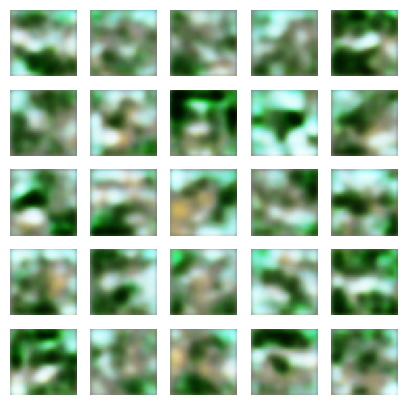

Epoch 2/80
1/1 [==============================] - 0s 16ms/step


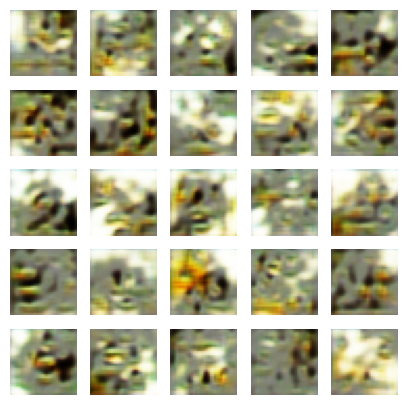

Epoch 3/80
1/1 [==============================] - 0s 15ms/step


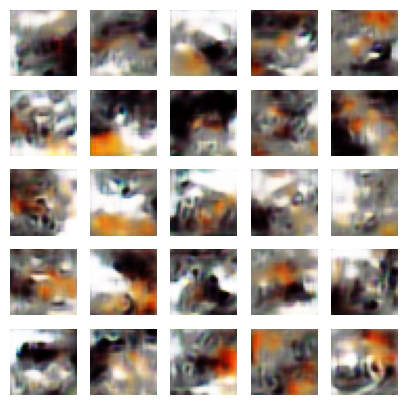

Epoch 4/80
1/1 [==============================] - 0s 19ms/step


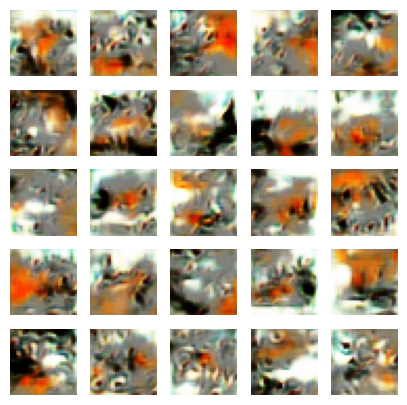

Epoch 5/80
1/1 [==============================] - 0s 25ms/step


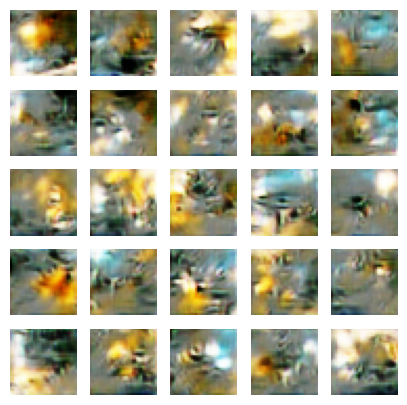

Epoch 6/80
1/1 [==============================] - 0s 17ms/step


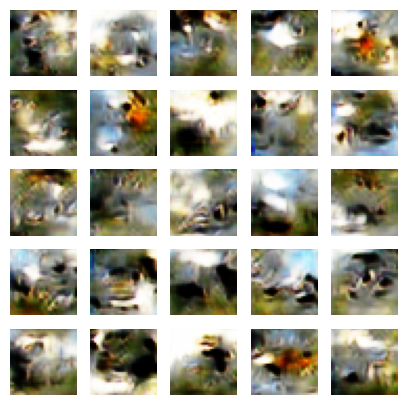

Epoch 7/80
1/1 [==============================] - 0s 17ms/step


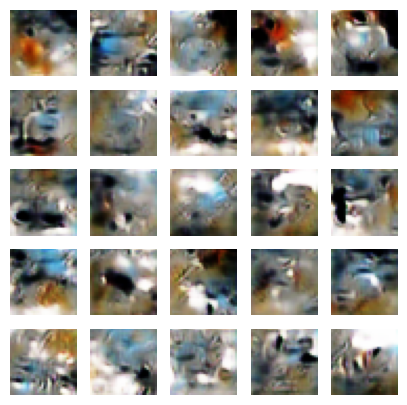

Epoch 8/80
1/1 [==============================] - 0s 17ms/step


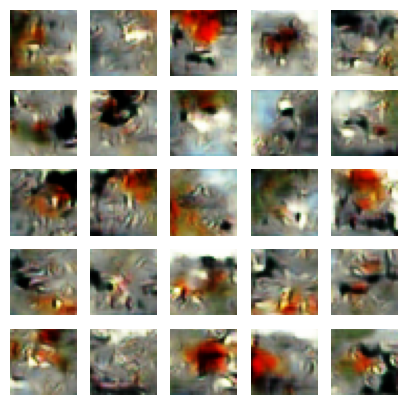

Epoch 9/80
1/1 [==============================] - 0s 18ms/step


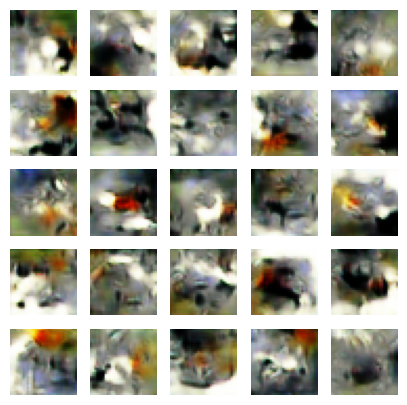

Epoch 10/80
1/1 [==============================] - 0s 17ms/step


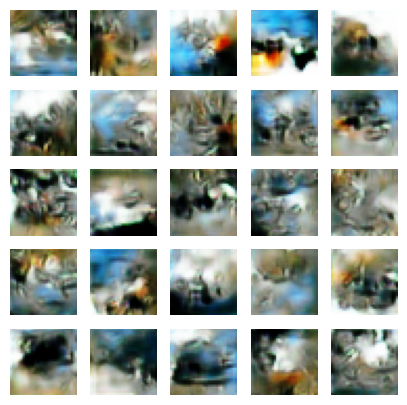

Epoch 11/80
1/1 [==============================] - 0s 16ms/step


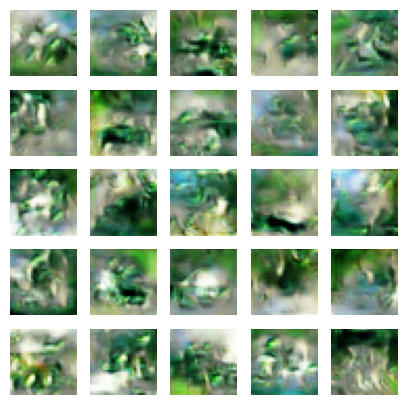

Epoch 12/80
1/1 [==============================] - 0s 24ms/step


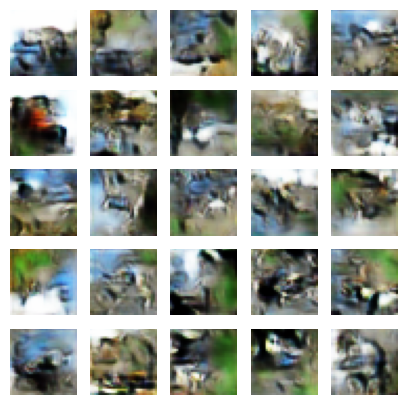

Epoch 13/80
1/1 [==============================] - 0s 17ms/step


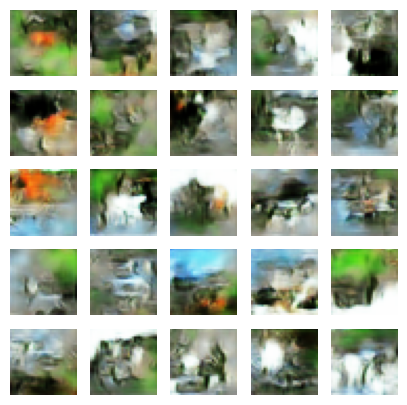

Epoch 14/80
1/1 [==============================] - 0s 16ms/step


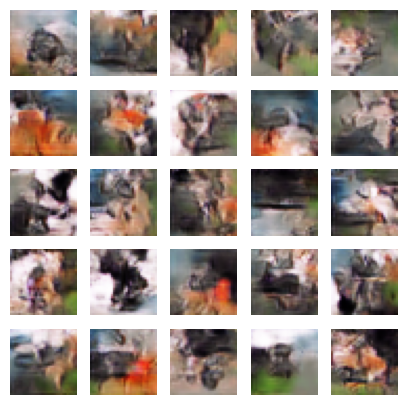

Epoch 15/80
1/1 [==============================] - 0s 16ms/step


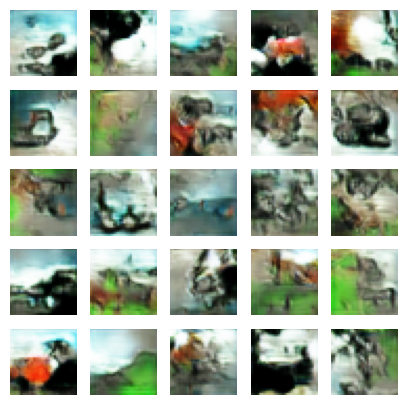

Epoch 16/80
1/1 [==============================] - 0s 17ms/step


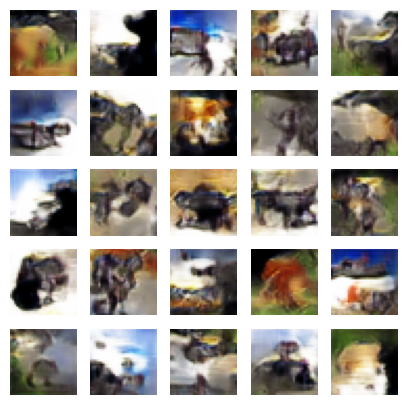

Epoch 17/80
1/1 [==============================] - 0s 16ms/step


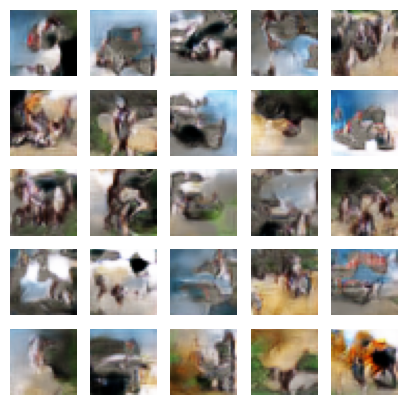

Epoch 18/80
1/1 [==============================] - 0s 22ms/step


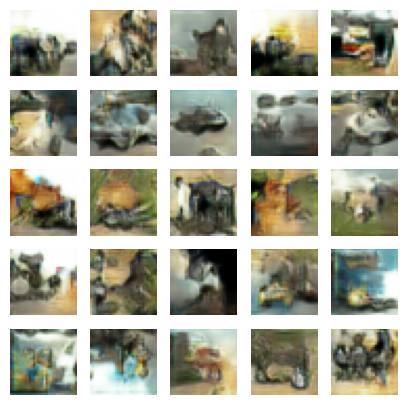

Epoch 19/80
1/1 [==============================] - 0s 17ms/step


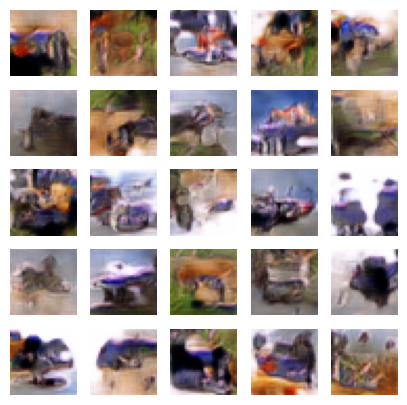

Epoch 20/80
1/1 [==============================] - 0s 19ms/step


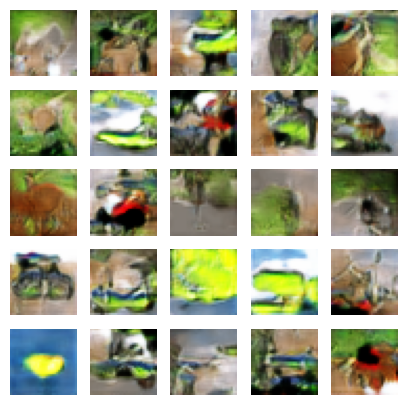

Epoch 21/80
1/1 [==============================] - 0s 17ms/step


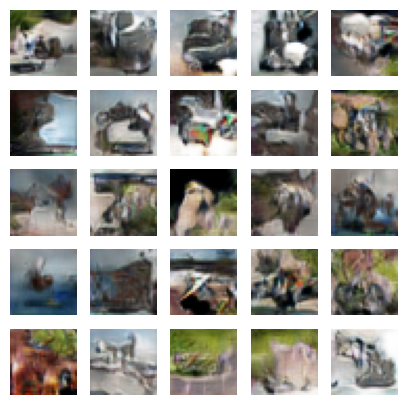

Epoch 22/80
1/1 [==============================] - 0s 25ms/step


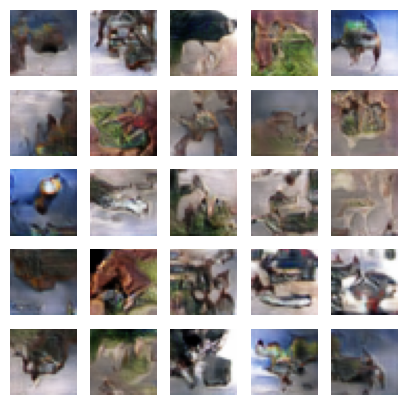

Epoch 23/80
1/1 [==============================] - 0s 16ms/step


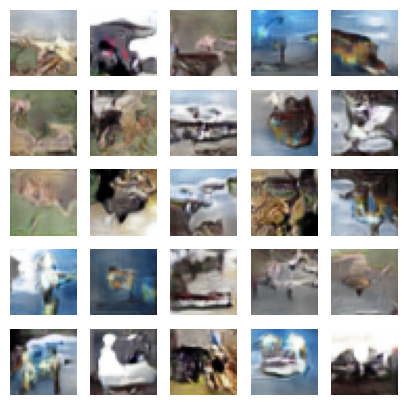

Epoch 24/80
1/1 [==============================] - 0s 16ms/step


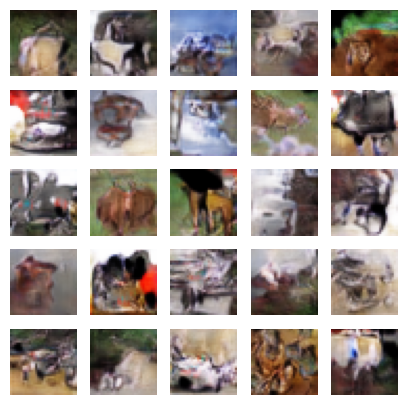

Epoch 25/80
1/1 [==============================] - 0s 17ms/step


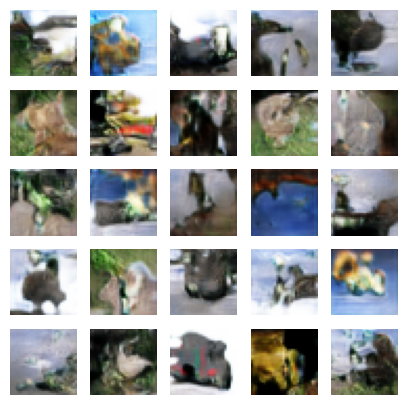

Epoch 26/80
1/1 [==============================] - 0s 18ms/step


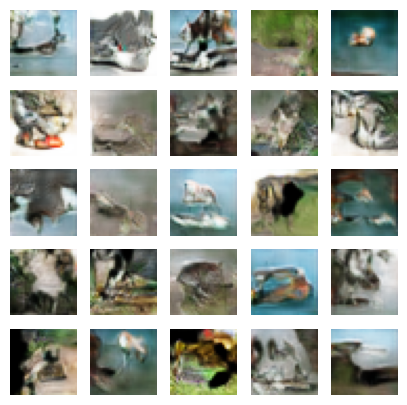

Epoch 27/80
1/1 [==============================] - 0s 18ms/step


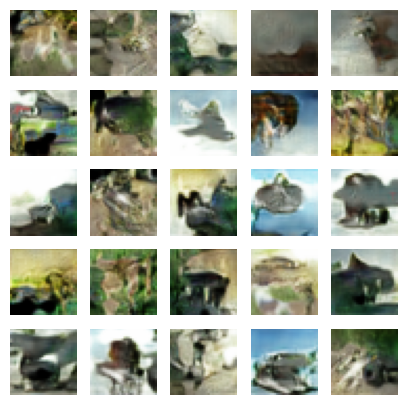

Epoch 28/80
1/1 [==============================] - 0s 17ms/step


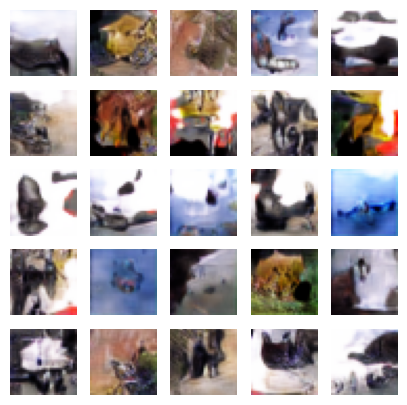

Epoch 29/80
1/1 [==============================] - 0s 17ms/step


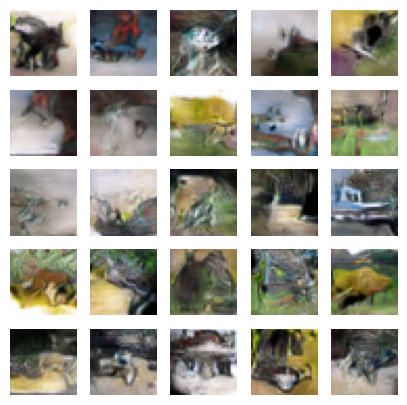

Epoch 30/80
1/1 [==============================] - 0s 17ms/step


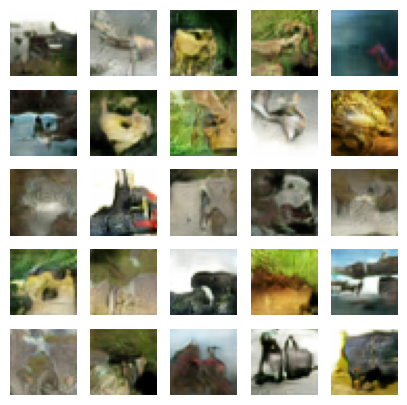

Epoch 31/80
1/1 [==============================] - 0s 16ms/step


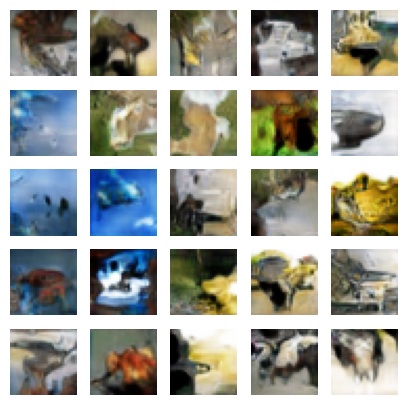

Epoch 32/80
1/1 [==============================] - 0s 18ms/step


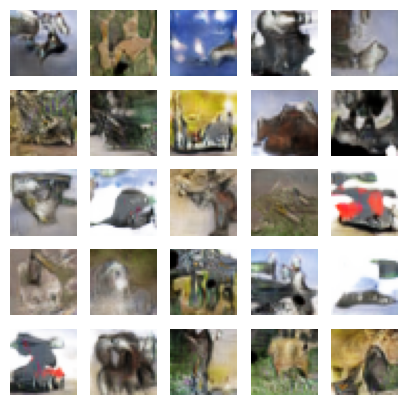

Epoch 33/80
1/1 [==============================] - 0s 16ms/step


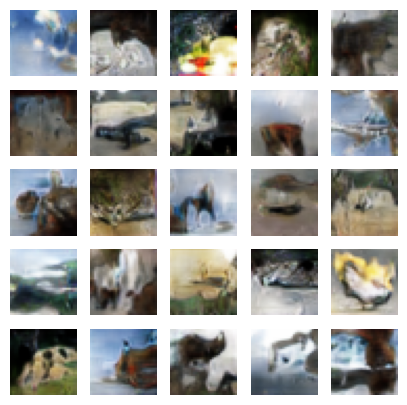

Epoch 34/80
1/1 [==============================] - 0s 17ms/step


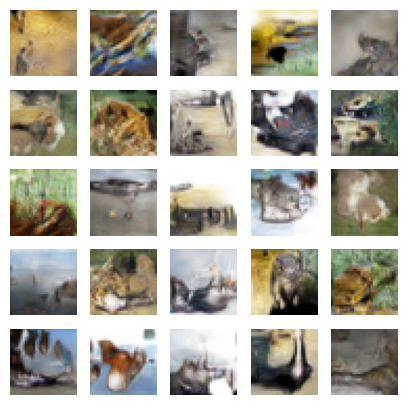

Epoch 35/80
1/1 [==============================] - 0s 17ms/step


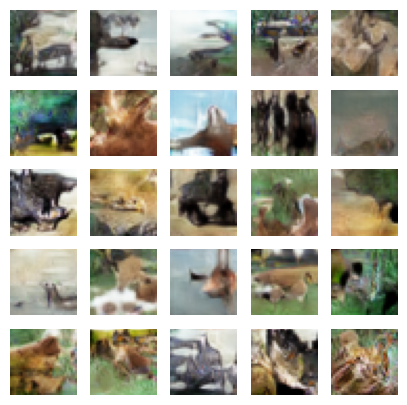

Epoch 36/80
1/1 [==============================] - 0s 17ms/step


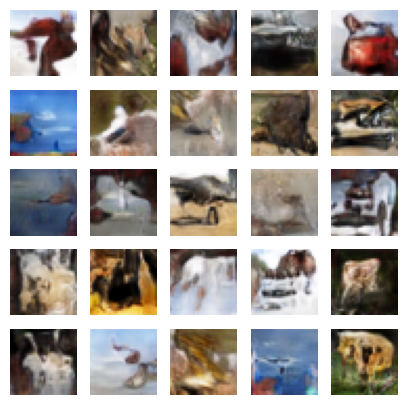

Epoch 37/80
1/1 [==============================] - 0s 16ms/step


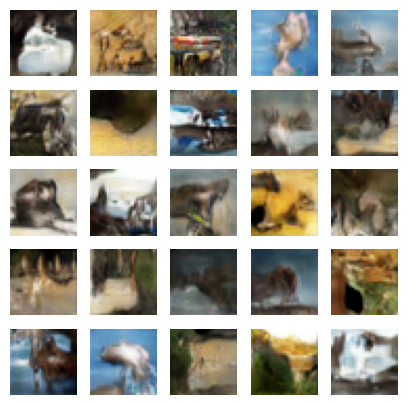

Epoch 38/80
1/1 [==============================] - 0s 19ms/step


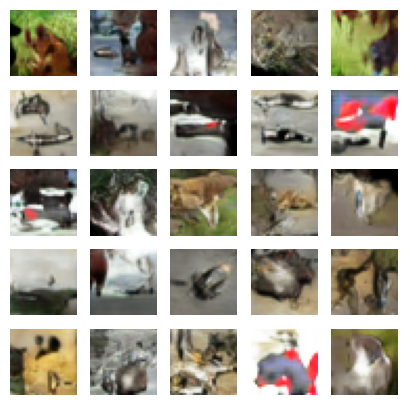

Epoch 39/80
1/1 [==============================] - 0s 20ms/step


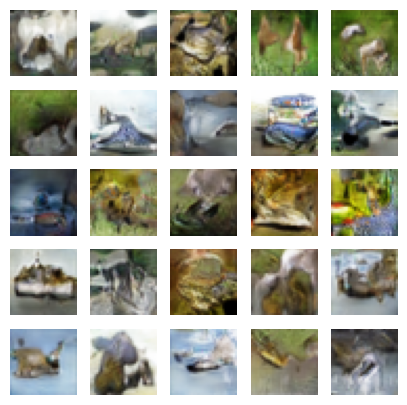

Epoch 40/80
1/1 [==============================] - 0s 20ms/step


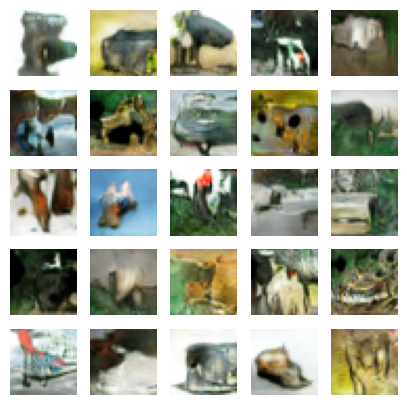

Epoch 41/80
1/1 [==============================] - 0s 17ms/step


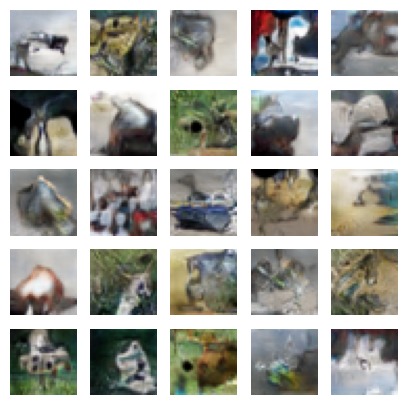

Epoch 42/80
1/1 [==============================] - 0s 17ms/step


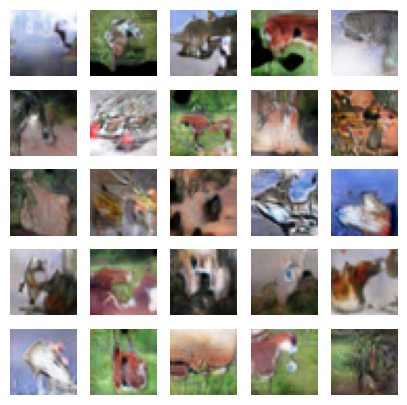

Epoch 43/80
1/1 [==============================] - 0s 19ms/step


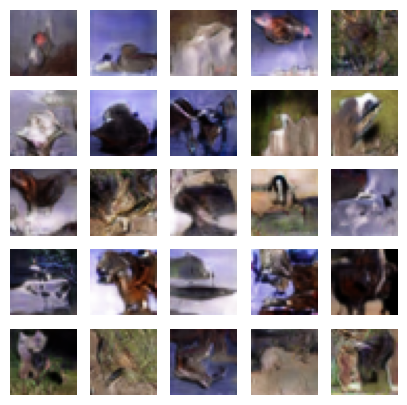

Epoch 44/80
1/1 [==============================] - 0s 18ms/step


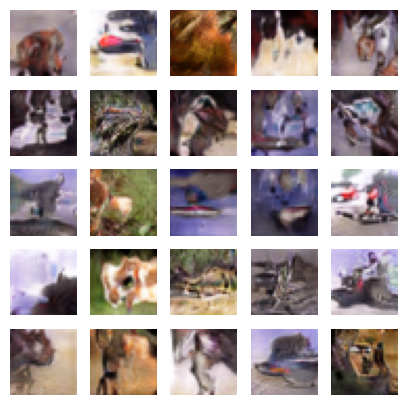

Epoch 45/80
1/1 [==============================] - 0s 16ms/step


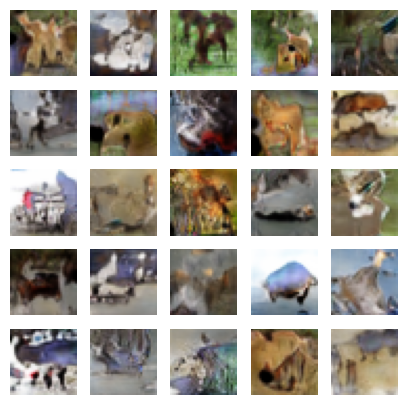

Epoch 46/80
1/1 [==============================] - 0s 17ms/step


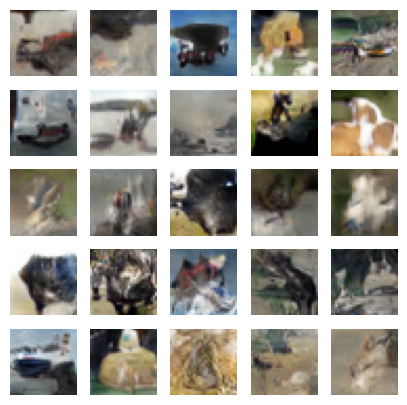

Epoch 47/80
1/1 [==============================] - 0s 18ms/step


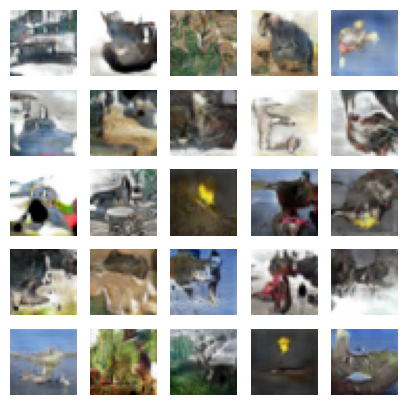

Epoch 48/80
1/1 [==============================] - 0s 17ms/step


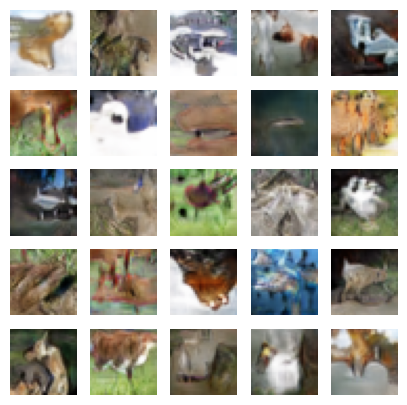

Epoch 49/80
1/1 [==============================] - 0s 16ms/step


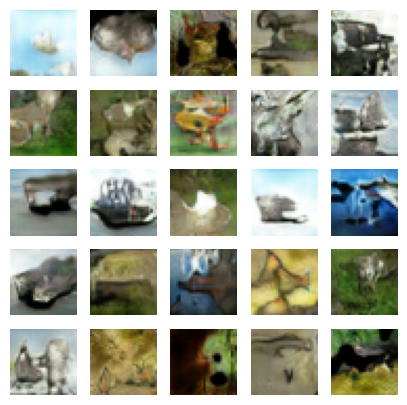

Epoch 50/80
1/1 [==============================] - 0s 17ms/step


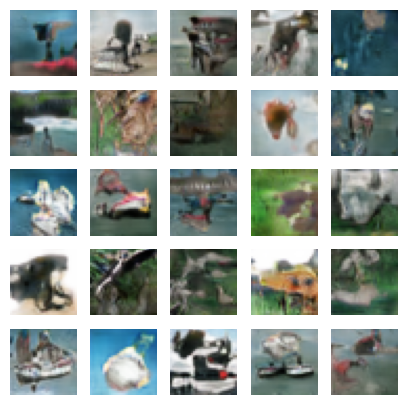

Epoch 51/80
1/1 [==============================] - 0s 21ms/step


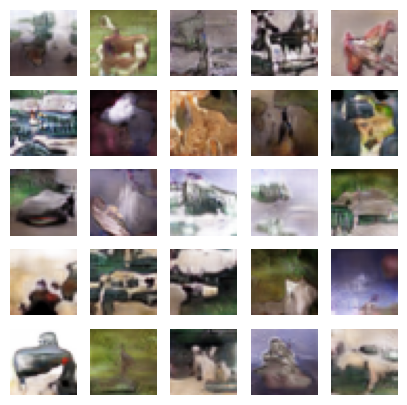

Epoch 52/80
1/1 [==============================] - 0s 19ms/step


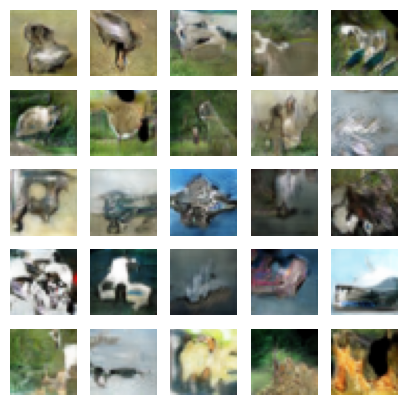

Epoch 53/80
1/1 [==============================] - 0s 16ms/step


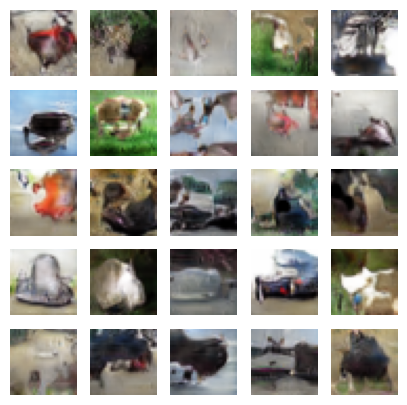

Epoch 54/80
1/1 [==============================] - 0s 24ms/step


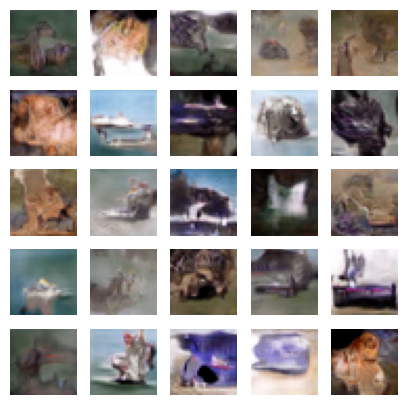

Epoch 55/80
1/1 [==============================] - 0s 17ms/step


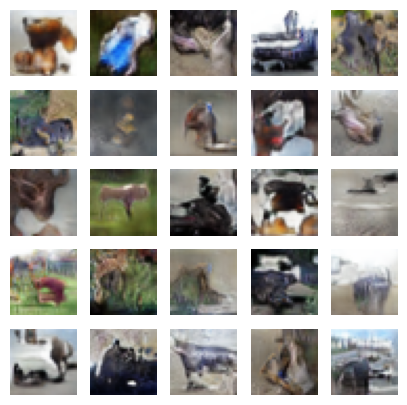

Epoch 56/80
1/1 [==============================] - 0s 17ms/step


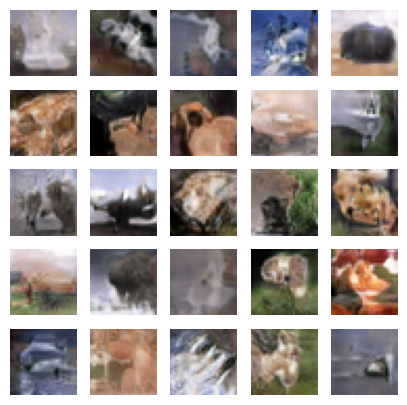

Epoch 57/80
1/1 [==============================] - 0s 16ms/step


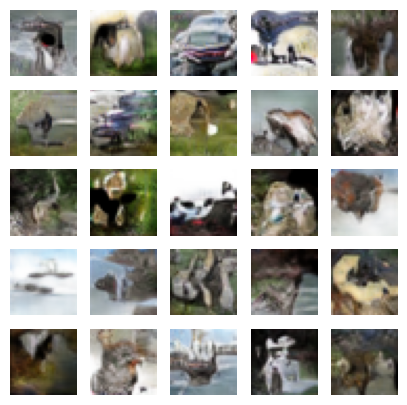

Epoch 58/80
1/1 [==============================] - 0s 17ms/step


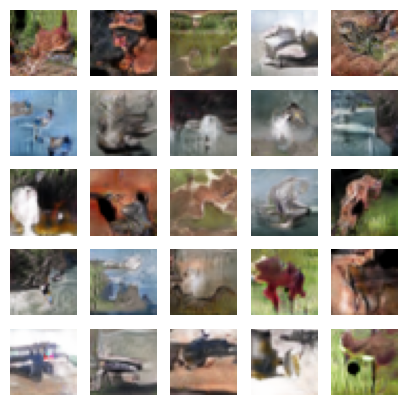

Epoch 59/80
1/1 [==============================] - 0s 16ms/step


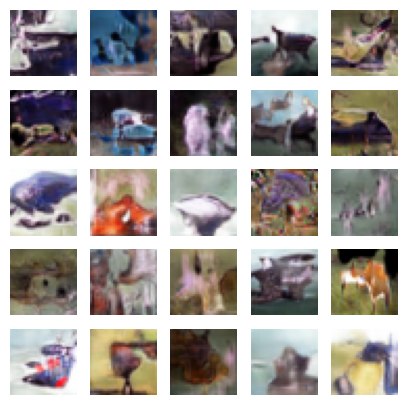

Epoch 60/80
1/1 [==============================] - 0s 18ms/step


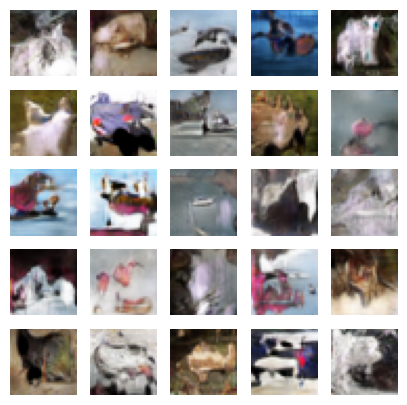

Epoch 61/80
1/1 [==============================] - 0s 16ms/step


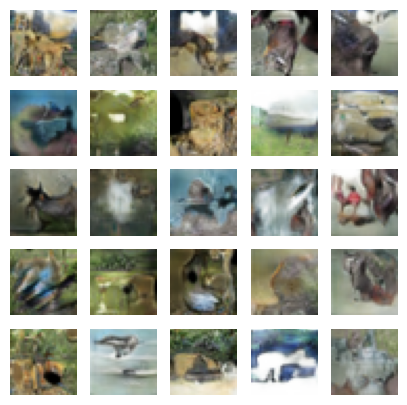

Epoch 62/80
1/1 [==============================] - 0s 25ms/step


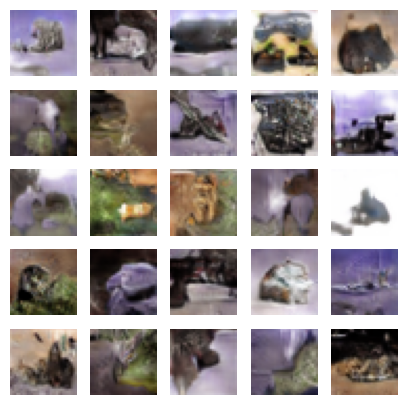

Epoch 63/80
1/1 [==============================] - 0s 16ms/step


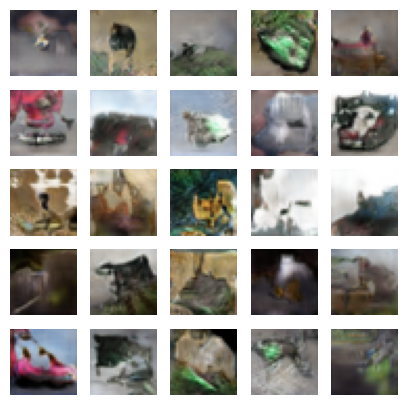

Epoch 64/80
1/1 [==============================] - 0s 17ms/step


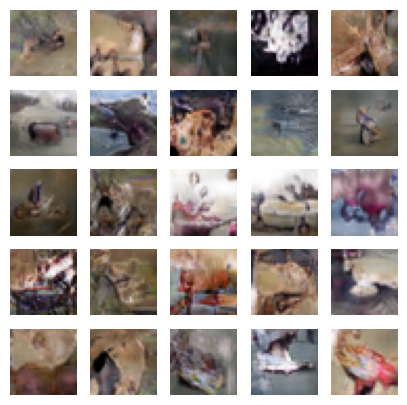

Epoch 65/80
1/1 [==============================] - 0s 17ms/step


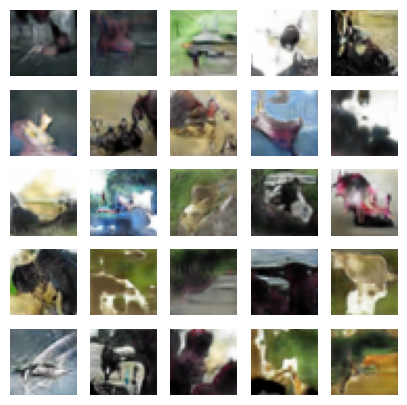

Epoch 66/80
1/1 [==============================] - 0s 18ms/step


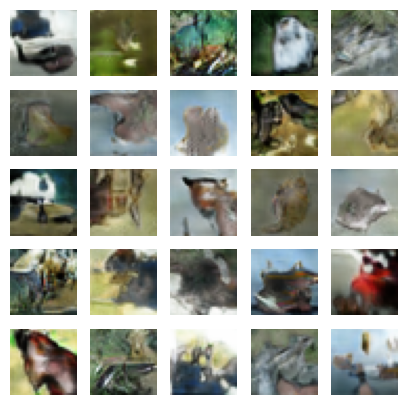

Epoch 67/80
1/1 [==============================] - 0s 17ms/step


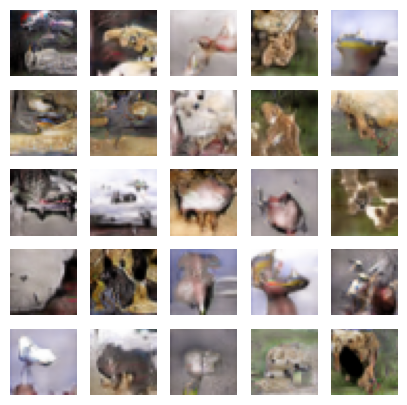

Epoch 68/80
1/1 [==============================] - 0s 18ms/step


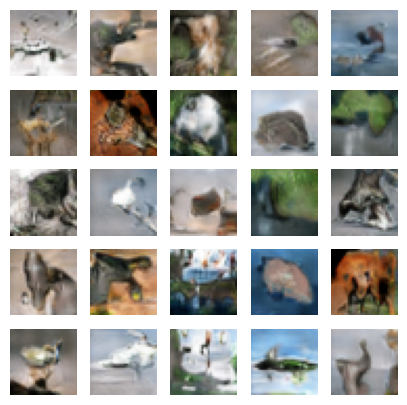

Epoch 69/80
1/1 [==============================] - 0s 16ms/step


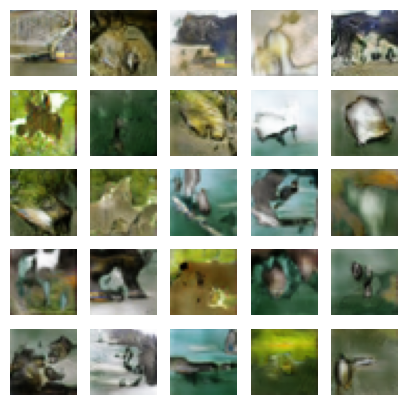

Epoch 70/80
1/1 [==============================] - 0s 17ms/step


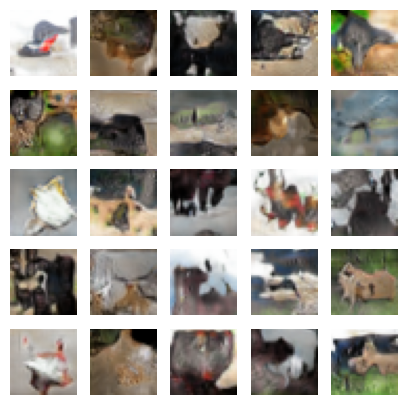

Epoch 71/80
1/1 [==============================] - 0s 17ms/step


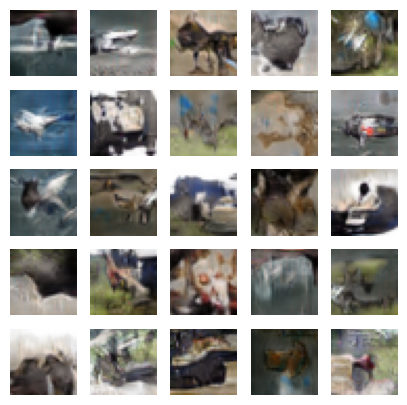

Epoch 72/80
1/1 [==============================] - 0s 28ms/step


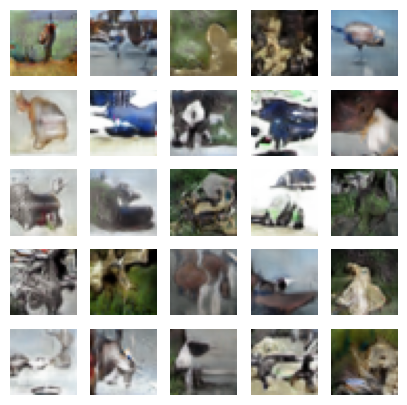

Epoch 73/80
1/1 [==============================] - 0s 18ms/step


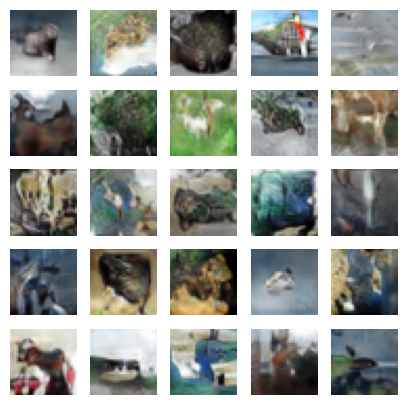

Epoch 74/80
1/1 [==============================] - 0s 17ms/step


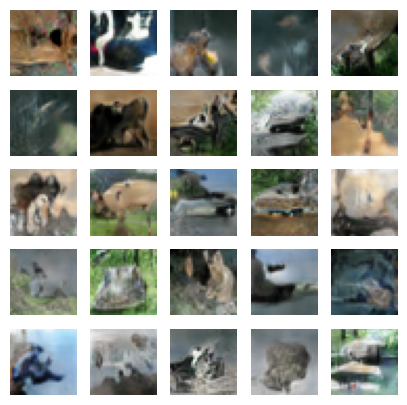

Epoch 75/80
1/1 [==============================] - 0s 16ms/step


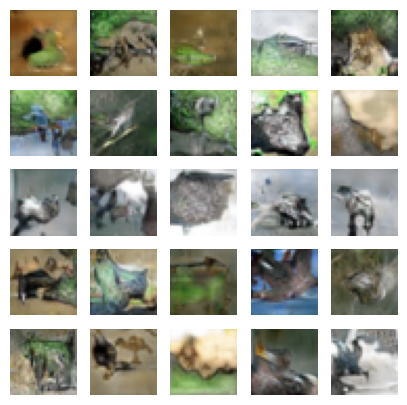

Epoch 76/80
1/1 [==============================] - 0s 17ms/step


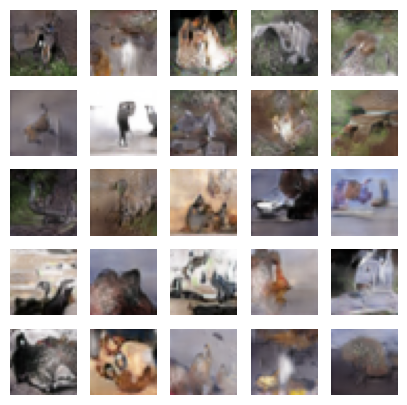

Epoch 77/80
1/1 [==============================] - 0s 16ms/step


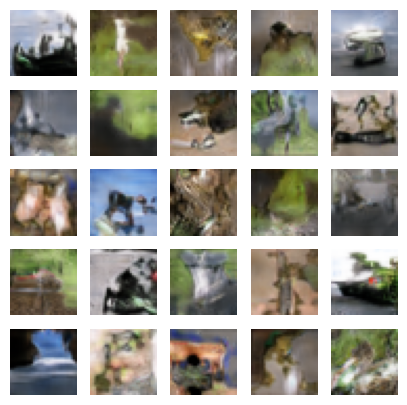

Epoch 78/80
1/1 [==============================] - 0s 18ms/step


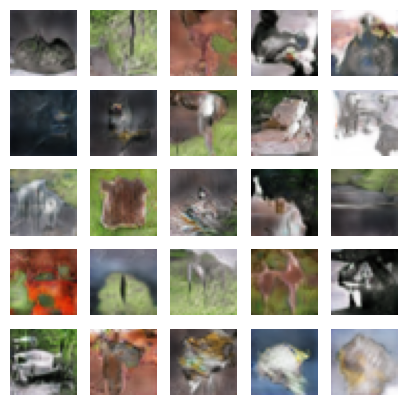

Epoch 79/80
1/1 [==============================] - 0s 17ms/step


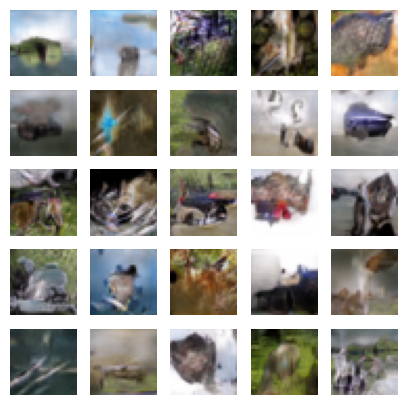

Epoch 80/80
1/1 [==============================] - 0s 34ms/step


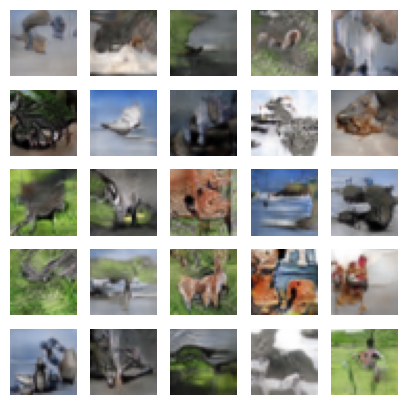

In [ ]:
import numpy as np

def train_gan(gan, dataset, batch_size, codings_size, n_epochs=50):
    generator, discriminator = gan.layers
    for epoch in range(n_epochs):
        exp_relay = []
        print(f"Epoch {epoch+1}/{n_epochs}")
        for i, X_batch in enumerate(dataset):
            # Phase 1 - training the discriminator
            noise = tf.random.normal(shape=[batch_size, codings_size])
            generated_images = generator(noise)
            X_batch_float = tf.cast(X_batch, tf.float32)
            X_fake_and_real = tf.concat([generated_images, X_batch_float], axis=0)
            y1 = tf.constant([[0.]] * batch_size + [[1.]] * batch_size)
            discriminator.trainable = True
            d_loss = discriminator.train_on_batch(X_fake_and_real, y1)

            # Phase 1.5 - experience realy
            for j in range(8):
              exp_relay.append(generated_images[j])
            if(len(exp_relay) == batch_size):
                y1 = tf.constant([[0.]] * batch_size)
                discriminator.train_on_batch(np.array(exp_relay), y1)
                exp_relay = []

            # Phase 2 - training the generator
            noise = tf.random.normal(shape=[batch_size, codings_size])
            y2 = tf.constant([[1.]] * batch_size)
            discriminator.trainable = False
            g_loss = gan.train_on_batch(noise, y2)

        # Logging
        generate_and_plot_images(generator, codings_size)


train_gan(gan, dataset, batch_size, codings_size, n_epochs=80)


Let's take many samples from our finished model.

2/2 [==============================] - 0s 5ms/step


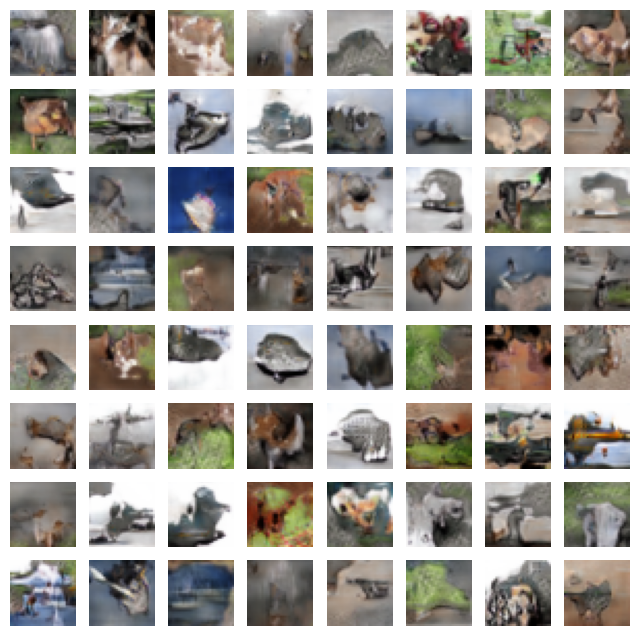

In [ ]:
generate_and_plot_images(generator, codings_size, num_images=64, figsize=(8, 8))

##**B: The Reason Behind Using Gradient Ascent in Training GANs**

Let's understand the intuition behind the GAN loss function first.

$$\Large{\min\limits_{G} \max\limits_{D} \mathbb{E}_{x \sim p_{\text{d}}(x)}[\log D(x)] + \mathbb{E}_{z \sim p_z(z)}[\log(1 - D(G(z)))]}$$

\\

Here, $D$ is the discriminator function that outputs either $0$ or $1$ based on **fake or real** image respectively. While $G$ is the generator function, which generates an image $x$ from noise. $p_d$ and $p_z$ are the distributions of the input image space and the input latent variable space respectively.

The **first part** $\mathbb{E}_{x \sim p_d(x)}[\log D(x)]$ is basically a mesure of telling **how good the discriminator is at telling whether a real image is real**.

Now the **second part** $\mathbb{E}_{z \sim p_z(z)}[\log(1 - D(G(z)))]$ is intuitively a mesure of **how good the discriminator is at telling if a fake image is fake**.

Now what is meant by saying "Training a GAN is like playing a **minimax** game"?

Looking at it from a game theory perspective, the generator is trying to **maximize** this function since it needs to classify **real images as real** and **fake images as fake**, this is exactly what **maximizing the first and second parts** does.

On the other hand, the generator is trying to create images that resemble the real ones to fool the discriminator, the first part of the loss function is **independent of $G(z)$**. The second part of the loss function is however, based on the generator, by trying to create images close to the real ones, the generator is essentially trying to **minimize this part** and thus **minimizing the whole function**.

\\

The Training proccess is just as we explained, we alternate between **gradient descent on the discriminator**:

$$\Large{D^* = \max\limits_{D} [\mathbb{E}_{x \sim p_{\text{d}}(x)}\log D(x) + \mathbb{E}_{z \sim p_z(z)}\log(1 - D(G(z)))]}$$


\\

And **gradient descent on the generator**:

$$\Large{G^* = \min\limits_{G} [\mathbb{E}_{z \sim p_z} \log(1-D^*(G(z)))]}$$

Notice how optimizing the function above using gradient descent corresponds to optimizing this function using **gradient ascent**:

$$\Large{G^* = \max\limits_{G} [\mathbb{E}_{z \sim p_z} \log(D^*(G(z)))]}$$


But why do practitioners optimize the **second function** using **gradient ascent**?

The answer lies whithin the behaviours of the gradients of these functions.

![chart](https://miro.medium.com/v2/resize:fit:2000/format:webp/1*m_--rujdZazTD-txYRkk1w.png)
*Source: [medium](https://medium.com/@sayansamanta/generative-adversarial-networks-smearing-the-gap-between-real-and-fake-588c4f81740a)*

The generator wants to **maximize the output of the discriminator for fake images** (minimizing generator loss).

The **blue line** shows how the first function (**gradient descent**) behaves. It has **lower gradients** **far away** from the **optimal** but **high around the optimal**. This is not ideal since we would want the **exact opposite** behaviour for **faster convergence**.

On the other hand, the **yellow line** shows how the second function (**gradient ascent**) behaves, the exact **opposite of the first function**.
It has **lower** gradients close to the **optimal** but **higher** gradient when **far away from the optimal**, this helps us get closer to the optimal point **(converge) faster** and thus is the preffered method.


# **Task 3**

In CNNs, the **initial** layers tend to detect **elementary features** such as straight lines, we call these first-layer features *general*.\
The features computed by the **last** layers of a trained network depend greatly on the chosen dataset and task (and thus identify more **abstract** and **complex** features). We call these last-layer features *specific*.

If first-layer features are general and last-layer features are specific, then there must be a transition from general to specific somewhere in the network.






## **A: Transfer Learning with Small and Dissimilar Datasets**

When dealing with dissimilar datasets, our target and training data don't share many features, thus by definition, there are less *general* layers that we can borrow from our pretrained model.

If the target dataset is small, fine-tuning may result in overfitting so it's a good idea to freeze the copied layers.


Thus our strategy is to use the first few layers from the pre-trained model that learn the general featuers and build on top of these features to learn more complicated features.

[This paper](https://arxiv.org/pdf/1411.1792.pdf) states that initializing a network with transferred features from almost any number
of layers can produce a boost to generalization performance after fine-tuning to a new dataset (regardless of similarity).

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential

I'll be using the citrus leaves dataset which is **really small**. It contains 594 images of citrus leaves with the following labels: Black Spot, Canker, Greening, and Healthy.\
This dataset and ImageNet don't have a lot in common so it's a good choice for this task.

In [ ]:
import tensorflow_datasets as tfds

# Load the dataset

dataset, info = tfds.load(
    "citrus_leaves",
    split="train",
    as_supervised=True,
    with_info=True
)

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/1 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/594 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/citrus_leaves/0.1.2.incompleteFE5XRG/citrus_leaves-train.tfrecord*...:   0…

Dataset citrus_leaves downloaded and prepared to /root/tensorflow_datasets/citrus_leaves/0.1.2. Subsequent calls will reuse this data.


In [ ]:
print("Number of Classes:", info.features['label'].num_classes)
print("Class Names:", info.features['label'].names)
print("Total Number of Examples:", info.splits['train'].num_examples)

Number of Classes: 4
Class Names: ['Black spot', 'canker', 'greening', 'healthy']
Total Number of Examples: 594


Labels should be converted to categorical format.

In [ ]:
from tensorflow.keras.utils import to_categorical

(images, labels) = zip(*dataset)

labels = to_categorical(labels)

Images must be 224*224 due to the specifics of our pretrained model.

In [ ]:
def format_image(image):
    image = tf.image.resize(image, (224, 224))/255.0
    return image

images = np.array([format_image(im) for im in images])

Train-test split should be performed next.


In [ ]:
from sklearn.model_selection import train_test_split

train_images, test_images, train_labels, test_labels = train_test_split(
    images, labels, test_size=0.2
)

Let us see some samples from the data.

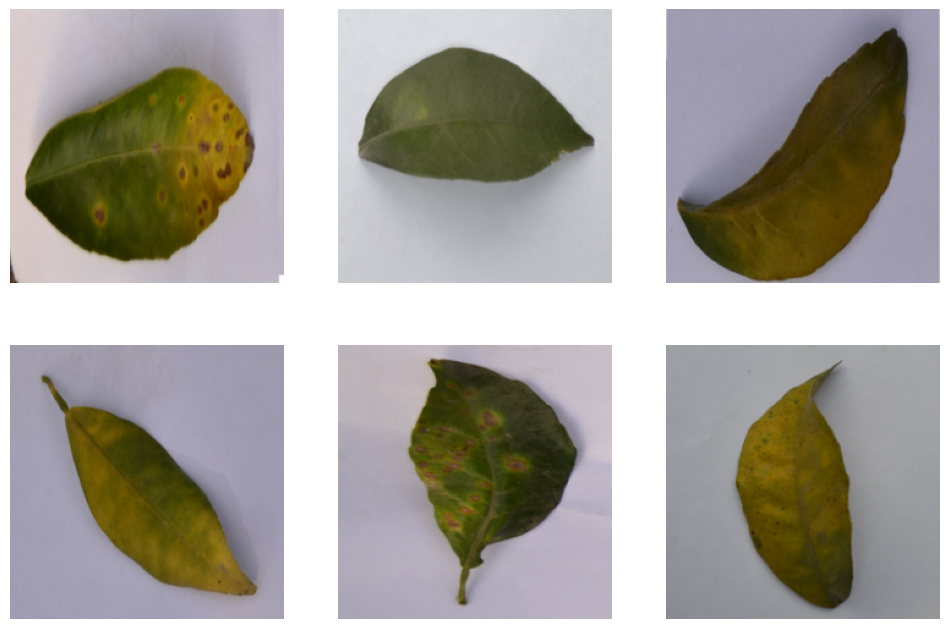

In [ ]:
import matplotlib.pyplot as plt

def show_images(images):
    plt.figure(figsize=(12, 8))
    for i in range(len(images)):
        plt.subplot(2, 3, i + 1)
        plt.imshow(images[i])
        plt.axis("off")
    plt.show()

show_images(images[:6])

Now that we are done with the data let's use VGG16 trained on ImageNet as our pretrained model, as discussed earlier, we should rely on the initial layers and build our model on top of them.

For this reason, I'll be freezing the first few layers and leave the rest untouched (as mentioned in the paper above, this should improve the results).

In [ ]:
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input

base_model = VGG16(weights="imagenet", include_top=False, input_shape=images[0].shape)

num_layers_to_freeze = 17

for layer in base_model.layers[:num_layers_to_freeze]:
    layer.trainable = False

base_model.summary()

58889256/58889256 [==============================] - 1s 0us/step
Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                              

The images must be preprocessed to ensure that they meet VGG requirements.

In [ ]:
train_images = preprocess_input(train_images)
test_images = preprocess_input(test_images)

Let us build our model on top of the pretrained model.

In [ ]:
from tensorflow.keras.layers import Dense, Dropout, Flatten, GlobalAveragePooling2D

model = Sequential([
    base_model,
    Flatten(),
    Dropout(0.3),
    Dense(4, activation='softmax'),
])

model.build([None, 224, 224, 3]) #input shape

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 flatten (Flatten)           (None, 25088)             0         
                                                                 
 dropout (Dropout)           (None, 25088)             0         
                                                                 
 dense (Dense)               (None, 4)                 100356    
                                                                 
Total params: 14815044 (56.51 MB)
Trainable params: 2460164 (9.38 MB)
Non-trainable params: 12354880 (47.13 MB)
_________________________________________________________________


We can now compile the model and train it.

In [ ]:
model.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy'],
)


# Train the model
history = model.fit(
    train_images,
    train_labels,
    batch_size=32,
    epochs=5,
    validation_split=0.2,
)

loss, accuracy = model.evaluate(test_images, test_labels)

print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/5
12/12 [==============================] - 262s 22s/step - loss: 9.3937 - accuracy: 0.5868 - val_loss: 3.8503 - val_accuracy: 0.7684
Epoch 2/5
12/12 [==============================] - 295s 25s/step - loss: 2.2342 - accuracy: 0.8658 - val_loss: 2.5460 - val_accuracy: 0.8737
Epoch 3/5
12/12 [==============================] - 292s 25s/step - loss: 1.3567 - accuracy: 0.9263 - val_loss: 4.2702 - val_accuracy: 0.7684
Epoch 4/5
12/12 [==============================] - 265s 23s/step - loss: 0.3252 - accuracy: 0.9789 - val_loss: 3.5557 - val_accuracy: 0.8316
Epoch 5/5
4/4 [==============================] - 64s 16s/step - loss: 3.0913 - accuracy: 0.8235
Test Loss: 3.091296434402466
Test Accuracy: 0.8235294222831726


And thus we get a fairly decent model given our extremely small dataset and only 5 epochs of training.

## **B: Transfer Learning with Small and Similar Datasets**

In this case, while it still is a good idea to freeze the initial layers to avoid overfitting due to the size of the target dataset, we can use more layers from the pre-trained model since the training and target data share more features.

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential

As my target dataset, I'll be using the imagenette dataset which is a smaller version of ImageNet. It satisfies both the qualities of being small and being similar to the source dataset. \

In [ ]:
import tensorflow_datasets as tfds

# Load the dataset

train_set, info = tfds.load(
    "imagenette",
    split="train",
    as_supervised=True,
    with_info=True
)

validation_set = tfds.load(
    "imagenette",
    split="validation",
    as_supervised=True,
)

In [ ]:
num_classes = info.features['label'].num_classes
num_training_examples = len(train_set)
num_validation_examples = len(validation_set)

print('Total Number of Classes: {}'.format(num_classes))
print('Total Number of Training Images: {}'.format(num_training_examples))
print('Total Number of Validation Images: {} \n'.format(num_validation_examples))

Total Number of Classes: 10
Total Number of Training Images: 9469
Total Number of Validation Images: 3925 



I'll be using **VGG16** pre-trained on the ImageNet dataset. `include_top` is set to `false` to remove the classification layer that was trained on the ImageNet dataset.

I will be freezing the initial layers of the pretrained model.

In [ ]:
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input

base_model = VGG16(weights="imagenet", include_top=False, input_shape=images[0].shape)

num_layers_to_freeze = 17

for layer in base_model.layers[:num_layers_to_freeze]:
    layer.trainable = False

base_model.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_18 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

Let us make the dataset even smaller by keeping only 10% of the images.

In [ ]:
train_set = train_set.take(num_training_examples//10)
validation_set = validation_set.take(num_validation_examples//10)

(train_ds, train_labels) = zip(*train_set)
(test_ds, test_labels) = zip(*validation_set)

print("Number of training examples:", len(train_ds))
print("Number of validation examples:", len(test_ds))

Number of training examples: 946
Number of validation examples: 392


We should resize the images to 224 * 224 since that's the input size of the pre-trained model.

In [ ]:
def format_image(image):
    image = tf.image.resize(image, (224, 224))/255.0
    return image

train_ds = np.array([format_image(im) for im in train_ds])
test_ds = np.array([format_image(im) for im in test_ds])

Let us have a look at the images.

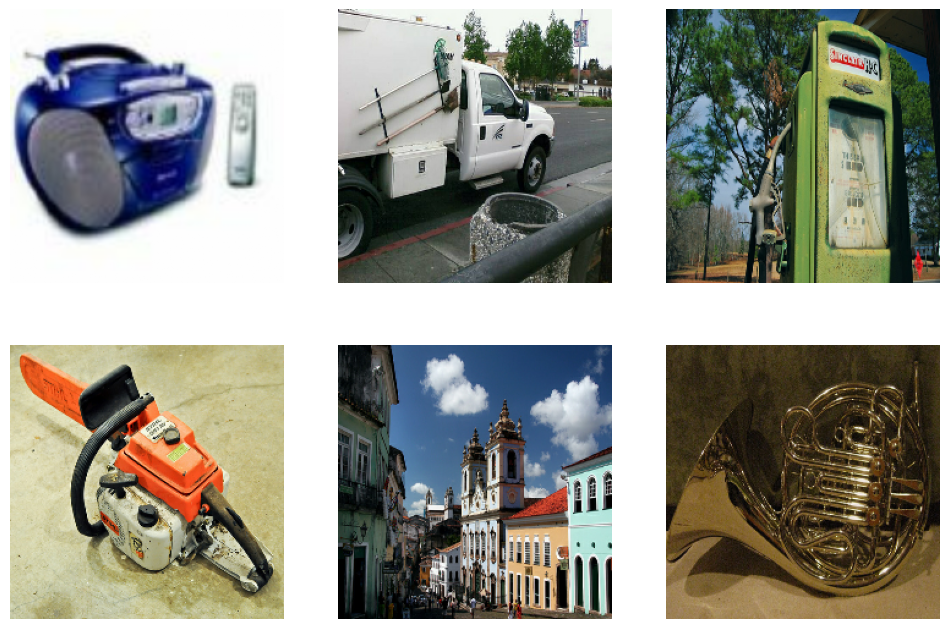

In [ ]:
import matplotlib.pyplot as plt

def show_images(images):
    plt.figure(figsize=(12, 8))
    for i in range(len(images)):
        plt.subplot(2, 3, i + 1)
        plt.imshow(images[i])
        plt.axis("off")
    plt.show()

show_images(train_ds[:6])

We should also transform the labels to correct format.

In [ ]:
from tensorflow.keras.utils import to_categorical

train_labels = to_categorical(train_labels)
test_labels = to_categorical(test_labels)

We now begin to build our model on top of the pre-trained model.

In [ ]:
from tensorflow.keras.layers import Dense, Dropout, Flatten, GlobalAveragePooling2D

model = Sequential([
    base_model,
    Flatten(),
    Dropout(0.3),
    Dense(10, activation='softmax'),
])
model.build([None, 224, 224, 3]) #input shape

model.summary()

Model: "sequential_32"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 flatten_18 (Flatten)        (None, 25088)             0         
                                                                 
 dropout_21 (Dropout)        (None, 25088)             0         
                                                                 
 dense_24 (Dense)            (None, 10)                250890    
                                                                 
Total params: 14965578 (57.09 MB)
Trainable params: 2610698 (9.96 MB)
Non-trainable params: 12354880 (47.13 MB)
_________________________________________________________________


Let's compile the model and train it.


In [ ]:
model.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy'],
)


# Train the model
history = model.fit(
    train_ds,
    train_labels,
    batch_size=32,$
    epochs=4,
    validation_split=0.2,
)

loss, accuracy = model.evaluate(test_ds, test_labels)

print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/4
24/24 [==============================] - 592s 25s/step - loss: 0.9131 - accuracy: 0.6931 - val_loss: 0.4116 - val_accuracy: 0.8684
Epoch 2/4
24/24 [==============================] - 581s 24s/step - loss: 0.0708 - accuracy: 0.9868 - val_loss: 0.5286 - val_accuracy: 0.8474
Epoch 3/4
24/24 [==============================] - 581s 24s/step - loss: 0.0255 - accuracy: 0.9960 - val_loss: 0.5500 - val_accuracy: 0.8474
Epoch 4/4
13/13 [==============================] - 219s 17s/step - loss: 0.6556 - accuracy: 0.8520
Test Loss: 0.6555938720703125
Test Accuracy: 0.8520408272743225


Given that this model aims to classify **10 classes** with **only 946** images, the results achieved are considered acceptable.\
It's evident that the model is **overfitting**, but this outcome is expected given the limited size of the dataset. To address overfitting, options such as **reducing the network's complexity** or implementing **data augmentation** could be considered. However, these approaches were deliberately omitted to observe the impact of having a small dataset.

# **Refrences**

[Hands-On Machine Learning with Scikit-Learn, Keras, and TensorFlow](https://www.oreilly.com/library/view/hands-on-machine-learning/9781492032632/)

[What Is Data Augmentation](https://aws.amazon.com/what-is/data-augmentation/#:~:text=Data%20augmentation%20is%20the%20process,machine%20learning%20(ML)%20models)

[Understanding VGG16: Concepts, Architecture, and Performance](https://datagen.tech/guides/computer-vision/vgg16/)

[Breaking the curse of small data sets in Machine Learning](https://towardsdatascience.com/breaking-the-curse-of-small-data-sets-in-machine-learning-part-2-894aa45277f4)

[How transferable are features in deep neural
networks?](https://arxiv.org/pdf/1411.1792)

[A Classification of Arab Ethnicity Based on Face Image Using Deep Learning Approach](https://www.researchgate.net/publication/350421671_A_Classification_of_Arab_Ethnicity_Based_on_Face_Image_Using_Deep_Learning_Approach)

[Deconvolution and Checkerboard Artifacts](https://distill.pub/2016/deconv-checkerboard/)

[Generative Adversarial Networks — Smearing the gap between real and fake](https://medium.com/@sayansamanta/generative-adversarial-networks-smearing-the-gap-between-real-and-fake-588c4f81740a)